In [1]:
import sys
sys.path.append("../")

In [2]:
import pandas as pd
import plotly.graph_objects as go
from plotting import CandlePlot
import numpy as np

from simulation.pair_trade_percent_binance import PairTradePercent
from technicals.indicators import Donchian_Close

from functools import reduce

In [3]:

from multiprocessing import Process, Manager
import pickle
import warnings
warnings.filterwarnings('ignore')

In [4]:
def calculate_correlation(df):
    """
    Calcula a correlação entre dois ativos com base nos retornos diários.
    """
    returns1 = df['Close_Pair1'].pct_change()
    returns2 = df['Close_Pair2'].pct_change()
    return returns1.corr(returns2)


from statsmodels.tsa.stattools import coint

def test_cointegration(df):
    """
    Testa a cointegração entre dois ativos com base nos preços de fechamento.
    """
    score, p_value, _ = coint(df['Close_Pair1'], df['Close_Pair2'])
    return p_value  # Retorna o p-valor do teste


from statsmodels.tsa.stattools import adfuller
import numpy as np

def test_spread_stationarity(df):
    """
    Verifica a estacionaridade do spread entre dois ativos.
    """
    # Calcular o beta (relação linear entre os ativos)
    prices1 = df['Close_Pair1'].values
    prices2 = df['Close_Pair2'].values
    beta = np.polyfit(prices2, prices1, 1)[0]
    
    # Calcular o spread
    spread = prices1 - beta * prices2
    
    # Teste de estacionaridade (ADF)
    adf_stat, p_value, _ = adfuller(spread)
    return p_value  # Retorna o p-valor do teste


def calculate_spread_volatility(df):
    """
    Calcula a volatilidade do spread entre dois ativos.
    """
    prices1 = df['Close_Pair1'].values
    prices2 = df['Close_Pair2'].values
    beta = np.polyfit(prices2, prices1, 1)[0]
    spread = prices1 - beta * prices2
    return np.std(spread)  # Retorna o desvio padrão do spread


In [5]:
def synchronize_dataframes(df_par1, df_par2):
    """
    Sincroniza os DataFrames pelo Timestamp.
    Retorna um DataFrame único contendo os preços de fechamento dos dois pares.
    """
    df = pd.merge(df_par1[['Time', 'Close']], 
                  df_par2[['Time', 'Close']], 
                  on='Time', 
                  suffixes=('_Pair1', '_Pair2'))
    df['Spread'] = df['Close_Pair1'] - df['Close_Pair2']
    return df




def calculate_zscore(df, window=50):
    """
    Calcula o Z-Score do spread usando uma janela móvel.
    :param df: DataFrame com a coluna 'Spread'.
    :param window: Tamanho da janela para calcular a média e o desvio padrão.
    :return: DataFrame atualizado com a coluna 'Z-Score'.
    """
    df['Spread_Mean'] = df['Spread'].rolling(window=window).mean()
    df['Spread_Std'] = df['Spread'].rolling(window=window).std()
    df['Z-Score'] = (df['Spread'] - df['Spread_Mean']) / df['Spread_Std']
    return df


In [6]:
def run_pair(granularity,
             lenght=10000,
             strategy=1,
             pair1='VIDTUSDT',
             pair2='TRXUSDT',
             entry_threshold=3,
             exit_threshold=0,
             window=50
            ):
    df_par1 = pd.read_pickle(f"crypto/{pair1}_{granularity}.pkl")
    df_par2 = pd.read_pickle(f"crypto/{pair2}_{granularity}.pkl")

    df = synchronize_dataframes(df_par1, df_par2)
    df = calculate_zscore(df, window=window)

    corr = calculate_correlation(df)
    # p_value = test_cointegration(df_par1, df_par2)
    # p_value_spread = test_spread_stationarity(df_par1, df_par2)
    spread_vol = calculate_spread_volatility(df)


    df['time'] = df['Time'].copy()
    df['strategy_pair1'] = 0
    # dff['returns'] = dff['Close'].pct_change()
    df['returns_pair1'] = np.log(df['Close_Pair1'] / df['Close_Pair1'].shift(1))
    df['creturns_pair1'] = df['returns_pair1'].cumsum()
    df['Log_Returns_pair1'] = np.log(df['Close_Pair1'] / df['Close_Pair1'].shift(1))
    df['cLog_Returns_pair1'] = df['Log_Returns_pair1'].cumsum()

    # df = df.iloc[lenght:]
    df = df[df['Time'] >= lenght]
    
    df.dropna(inplace=True)
    
    df.reset_index(drop=True, inplace=True)


    

    
    gt = PairTradePercent(
        df,
        strategy,
        entry_threshold,
        exit_threshold,
        corr,
        spread_vol
    )
    
    gt.run_test()
    return gt
    

In [7]:
# df = run_pair(pair='BTCUSDT', 
#               granularity='1m', 
#               ema=10,
#               lenght=10000, 
#               pairs_trade_benchmark = ["BTCUSDT",'ETHUSDT','BNBUSDT','LTCUSDT'],
#             window_percent=100,
#             ema_percent1=100,
#             ema_percent2=100,)


In [8]:
# df.columns

In [13]:
# 'BTCUSDT','ETHUSDT','BNBUSDT', 'ETCUSDT','ACHUSDT','DOGEUSDT', 'XRPUSDT'

pairs1 = ['DOTUSDT','ADAUSDT','TRXUSDT','XLMUSDT','APTUSDT','VIDTUSDT','AVAXUSDT','LTCUSDT','LINKUSDT',
         'BCHUSDT','EOSUSDT','DASHUSDT','ALGOUSDT','SANDUSDT',
         'ARUSDT', 'INJUSDT', 'MASKUSDT', 'CELOUSDT', 'BANDUSDT', 'ALPHAUSDT', 'PERPUSDT',
          'CHRUSDT', 'BELUSDT']
pairs2 = ['DOTUSDT','DOGEUSDT','ADAUSDT','XRPUSDT','TRXUSDT','XLMUSDT','APTUSDT','VIDTUSDT','BTCUSDT',
          'ETHUSDT','AVAXUSDT','BNBUSDT','LTCUSDT','LINKUSDT',
         'BCHUSDT','EOSUSDT','ETCUSDT','DASHUSDT','ALGOUSDT','SANDUSDT',
         'ARUSDT', 'INJUSDT', 'MASKUSDT', 'CELOUSDT', 'BANDUSDT', 'ALPHAUSDT', 'PERPUSDT',
         'ACHUSDT', 'CHRUSDT', 'BELUSDT']


# pairs1 = ['BELUSDT']
# pairs2 = ['DOTUSDT']

In [14]:
# from multiprocessing import Manager, Process
# import pandas as pd

# # Função para processar cada combinação de pares
# def run_process(L, arg):
#     pair1 = arg['pair1']
#     pair2 = arg['pair2']
#     granularity = arg['granularity']

#     try:
#         if pair1 == pair2:
#             return  # Ignorar pares iguais

#         df_par1 = pd.read_pickle(f"crypto/{pair1}_{granularity}.pkl")
#         df_par2 = pd.read_pickle(f"crypto/{pair2}_{granularity}.pkl")

#         df = synchronize_dataframes(df_par1, df_par2)
#         df = df[df['Time'] >= '2024-10-01 00:00:00']
#         corr = calculate_correlation(df)
#         p_value = test_cointegration(df)
#         spread_vol = calculate_spread_volatility(df)

#         dic_ = {
#             'pair1': pair1,
#             'pair2': pair2,
#             'corr': corr,
#             'p_value': p_value,
#             'spread_vol': spread_vol,
#         }

#         L.append(dic_)  # Adicionar o resultado à lista compartilhada

#     except Exception as e:
#         print(f"Error processing {pair1}-{pair2}: {e}")

# # Função principal para coordenar os processos
# def parallel_process_pairs(pairs1, pairs2, granularity, limit=10):
#     with Manager() as manager:
#         L = manager.list()  # Lista compartilhada entre processos
#         args_list = [
#             {'pair1': pair1, 'pair2': pair2, 'granularity': granularity}
#             for pair1 in pairs1
#             for pair2 in pairs2
#             if pair1 != pair2
#         ]

#         print(f"Total tasks: {len(args_list)}")
#         current = 0

#         while current < len(args_list):
#             print(current, flush=True)
#             processes = []
#             todo = len(args_list) - current
#             batch_limit = min(limit, todo)  # Controla o tamanho do lote

#             for _ in range(batch_limit):
#                 processes.append(Process(target=run_process, args=(L, args_list[current])))
#                 current += 1

#             # Iniciar os processos
#             for p in processes:
#                 p.start()

#             # Esperar que todos os processos terminem
#             for p in processes:
#                 p.join()

#         print("ALL DONE")
#         return list(L)  # Converter a lista compartilhada para uma lista normal

# granularity = "1m"

# results = parallel_process_pairs(pairs1, pairs2, granularity, limit=2)

# print(f"Processed {len(results)} pairs.")


granularity = '1m'
for pair1 in pairs1:
        for pair2 in pairs2:
            if pair1 != pair2:
                count+=1
print(count)
                
count = 0
for pair1 in pairs1:
        for pair2 in pairs2:
            if pair1 != pair2:
                print(count)
                try:
                    count += 1
                    df_par1 = pd.read_pickle(f"crypto/{pair1}_{granularity}.pkl")
                    df_par2 = pd.read_pickle(f"crypto/{pair2}_{granularity}.pkl")
                
                    df = synchronize_dataframes(df_par1, df_par2)
                    df = df[df['Time'] >= '2024-10-01 00:00:00']
                    corr = calculate_correlation(df)
                    p_value = test_cointegration(df)
                    # p_value_spread = test_spread_stationarity(df)
                    spread_vol = calculate_spread_volatility(df)
    
                    dic_ = {
                        'pair1': pair1,
                        'pair2':pair2,
                        'corr':corr,
                        'p_value':p_value,
                        # 'p_value_spread':p_value_spread,
                        'spread_vol':spread_vol,
                    }
                    dic_list.append(dic_)
                except Exception as e:
                    print(f"Error processing {pair1}-{pair2}: {e}")


NameError: name 'count' is not defined

In [51]:
df_corr = pd.DataFrame(dic_list)
df_corr

,pair1,pair2,corr,p_value,spread_vol
0,DOTUSDT,DOGEUSDT,0.631816,0.408749,0.131224
1,DOTUSDT,ADAUSDT,0.731937,0.584913,0.081676
2,DOTUSDT,XRPUSDT,0.584754,0.434155,0.110608
3,DOTUSDT,TRXUSDT,0.193627,0.180939,0.125580
4,DOTUSDT,XLMUSDT,0.388005,0.591640,0.104146
5,DOTUSDT,APTUSDT,0.479478,0.131437,0.117509
6,DOTUSDT,VIDTUSDT,0.334012,0.357059,0.132322
7,DOTUSDT,DOGEUSDT,0.631816,0.408749,0.131224
8,DOTUSDT,ADAUSDT,0.731937,0.584913,0.081676
9,DOTUSDT,XRPUSDT,0.584754,0.434155,0.110608


In [15]:
def get_list_args():
    args_dic_list = []
    for pair1 in pairs1:
        for pair2 in pairs2:
            if pair1 != pair2:
                for granularity in ['1m']:
                    for lenght in ['2023-01-01 00:00:00']:
                        for strategy in [1]:
                            for entry_threshold in [5]:
                                for exit_threshold in [0]:
                                    for window in [200]:
                                    
                                        args_dic = {
                                            "granularity":granularity,
                                            'lenght': lenght,
                                            'strategy':strategy,
                                            'pair1': pair1,
                                            'pair2':pair2,
                                            'entry_threshold':entry_threshold,
                                            'exit_threshold':exit_threshold,
                                            'window':window
                                        }
                                        args_dic_list.append(args_dic)

    return args_dic_list

In [16]:

def run_process(L, arg):
    # print("PROCESS",arg)
    L.append(
        dict(
            arg=arg,
            pair1=arg['pair1'],
            pair2=arg['pair2'],
            granularity=arg['granularity'],
            lenght = arg['lenght'],
            strategy = arg['strategy'],
            entry_threshold = arg['entry_threshold'],
            exit_threshold = arg['exit_threshold'],
            window = arg['window'],
            res=run_pair(
                granularity=arg['granularity'],
                lenght = arg['lenght'],
                strategy= arg['strategy'],
                pair1=arg['pair1'],
                pair2=arg['pair2'],
                entry_threshold = arg['entry_threshold'],
                exit_threshold = arg['exit_threshold'],
                window = arg['window']
            )
        )
    )


lista = []
def run_ema_macd():
    with Manager() as manager:
        global lista
        L = manager.list()  # <-- can be shared between processes.
        args_list = get_list_args()
        print(len(args_list))
        limit = 10
        current = 0
    
        while current < len(args_list):
            print(current)
            processes = []
            todo = len(args_list) - current
            if todo < limit:
                limit = todo
    
            for _ in range(limit):
                processes.append(Process(target=run_process, args=(L,args_list[current])))
                current += 1
    
            for p in processes:
                p.start()
    
            for p in processes:
                p.join()

        print("ALL DONE")
        lista = list(L)
        

In [17]:
%%time

run_ema_macd()

667
0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250
260
270
280
290
300
310
320
330
340
350
360
370
380
390
400
410
420
430
440
450
460
470
480
490
500
510
520
530
540
550
560
570
580
590
600
610
620
630
640
650
660
ALL DONE
CPU times: user 2.3 s, sys: 14.8 s, total: 17.1 s
Wall time: 6min 31s


In [13]:
# with open(f"./result-binance-acumulative-percentual-st-14ssss.pkl", "wb") as f:
#     pickle.dump(lista, f)  # Usa o pickle para salvar o arquivo


# with open(f"result-binance-acumulative-percentual-new-data-strategy-14-1min-2022.pkl", "rb") as f:
#     res = pickle.load(f)

In [14]:
# ddf.columns

In [15]:
# ddf.describe()

In [25]:
res = lista


In [26]:

dic_res = []
for r in res:

    if r['res'].len_close > 0:
        signal_up = r['res'].df_results.SIGNAL_UP.values[-1]

        res_pos_s = r['res'].df_results[r['res'].df_results['strategy_pair1'] > 0]
        res_neg_s = r['res'].df_results[r['res'].df_results['strategy_pair1'] <= 0]
        sum_neg_s = res_neg_s.strategy_pair1.sum() *-1
        sum_pos_s = res_pos_s.strategy_pair1.sum()
        dic_res.append(
            dict(
                pair1 = r['pair1'],
                pair2 = r['pair2'],
                granularity = r['granularity'],
                strat = round(r['res'].df_results.strategy_pair1.sum(),3),
                c = r['res'].df_results['count'].mean(),
                max_o = max(r['res'].df_results.total_opened),
                st = r['res'].strategy,
                entry_threshold = r['entry_threshold'],
                corr = r['res'].corr,
                spread_vol = r['res'].spread_vol,
                s_p_strat = sum_pos_s,
                s_n_strat = sum_neg_s,
                Rel_sum = sum_pos_s/(sum_pos_s+ sum_neg_s),

                
                l_p_strat = len(res_pos_s),
                l_n_strat = len(res_neg_s),
                Rel_len = len(res_pos_s)/(len(res_pos_s)+ len(res_neg_s)),

                l_c = r['res'].len_close,
                l_o = r['res'].len_open,
                   

                first_p = r['res'].first_price,
                last_p = r['res'].last_price,

                first_t = r['res'].df_results.start_time.values[0],
                last_t = r['res'].df_results.end_time.values[-1],
                
                r = r['res'].df_results,
                # df = r['res'].df
            )
    )
    # print(f"p={p}  e={e}  dw={dw}  dwp={dwp}   strategy={st}   result={result}")


In [27]:
pd.set_option('display.max_columns', None)

df_res = pd.DataFrame(dic_res)



print(df_res.columns)




Index(['pair1', 'pair2', 'granularity', 'strat', 'c', 'max_o', 'st',
       'entry_threshold', 'corr', 'spread_vol', 's_p_strat', 's_n_strat',
       'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'first_p',
       'last_p', 'first_t', 'last_t', 'r'],
      dtype='object')


In [28]:
pd.set_option('display.max_rows', None)

In [14]:
df_res_test = df_res.copy()

df_res_test = df_res_test.sort_values(by=['pair1','strat'], ascending=False).reset_index(drop=True)
df = df_res_test[['pair1','pair2', 'granularity', 'strat', 'entry_threshold', 'c', 'max_o', 'st','spread_vol','corr' ,'s_p_strat',
       's_n_strat', 'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c',
       'l_o', 'first_p', 'last_p', 'first_t', 'last_t']]
df

NameError: name 'df_res' is not defined

In [36]:
# df_res_test.info()

In [37]:
# # Lista de colunas que são parâmetros e de 'strat'
# # Excluímos colunas que não são parâmetros relevantes para o agrupamento
# param_cols = [col for col in df_res_test.columns if col not in ['pair', 'granularity', 'ema_s', 'ema_l', 'strat','strat_real', 'res', 'sig', 'c',
#        'wp', 'rsi_f', 'rsi_w', 'adx_f', 'adx_w', 'max_o','s_p_strat', 's_n_strat', 'Rel_sum', 'l_p_strat',
#        'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg', 'sum_pos',
#        'sum_neg', 'Rel_len_pos_neg', 'Rel_pos_neg', 'first_p', 'last_p','s_p_strat_',
#        'first_t', 'last_t', 'r', 'df']]


# # Encontrar a combinação de parâmetros com o melhor desempenho em algum ativo
# best_params_max = df_res_test.groupby(param_cols)['strat_real'].max().sort_values(ascending=False).reset_index()
# print("Melhores parâmetros pelo desempenho máximo:")
# print(best_params_max)

In [38]:

# # Encontrar a combinação de parâmetros com o melhor desempenho em algum ativo
# best_params_max = df_res_test.groupby(param_cols)['Rel_sum'].max().sort_values(ascending=False).reset_index()
# print("Melhores parâmetros pelo desempenho máximo:")
# print(best_params_max)

In [39]:
# # Exemplo de uso:
# # df = ... # seu DataFrame com os dados de backtest
# melhores_parametros = filtro_melhores_parametros(df_res_test, column='strat_real')
# print("Melhores parâmetros pelo desempenho médio:")
    
# melhores_parametros

In [40]:
# # Exemplo de uso:
# # df = ... # seu DataFrame com os dados de backtest
# melhores_parametros = filtro_melhores_parametros(df_res_test, column='Rel_sum')
# print("Melhores parâmetros pelo desempenho médio:")
    
# melhores_parametros

In [41]:
# analise_distribuicao(df_res_test, 'strat_real')


In [42]:
# importancia_parametros = analise_sensibilidade_parametros(df_res_test)
# importancia_parametros

In [43]:

df_result = df_res_test.iloc[0].r
df_result.describe()

,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time
count,117.000000,117.000000,117.0,117.000000,117.000000,117.0,117.0,1.170000e+02,1.170000e+02,117.000000,117.000000,117.000000,117.000000,117.000000,117,117
mean,439647.367521,43.572650,0.0,0.001211,0.002011,1.0,0.0,5.000000e-02,-5.000000e-02,0.519758,0.519551,0.512821,0.487179,0.000971,2023-11-02 10:35:49.743589888,2023-11-02 09:53:15.384615680
min,542.000000,2.000000,0.0,-0.024094,-0.023294,1.0,0.0,5.000000e-02,-5.000000e-02,0.337100,0.338000,0.000000,0.000000,-0.016200,2023-01-01 10:34:00,2023-01-01 09:51:00
25%,200906.000000,29.000000,0.0,-0.004271,-0.003471,1.0,0.0,5.000000e-02,-5.000000e-02,0.480700,0.482500,0.000000,0.000000,-0.001600,2023-05-20 15:49:00,2023-05-20 14:59:00
50%,394304.000000,42.000000,0.0,-0.001388,-0.000588,1.0,0.0,5.000000e-02,-5.000000e-02,0.514100,0.514700,1.000000,0.000000,-0.000300,2023-10-01 23:09:00,2023-10-01 22:17:00
75%,694497.000000,52.000000,0.0,0.001975,0.002775,1.0,0.0,5.000000e-02,-5.000000e-02,0.545800,0.546200,1.000000,1.000000,0.001500,2024-04-27 09:52:00,2024-04-27 09:30:00
max,957530.000000,132.000000,0.0,0.077166,0.077966,1.0,0.0,5.000000e-02,-5.000000e-02,0.713500,0.713500,1.000000,1.000000,0.045100,2024-10-27 01:54:00,2024-10-27 01:23:00
std,264136.148447,22.884386,0.0,0.013624,0.013624,0.0,0.0,6.968739e-18,6.968739e-18,0.072139,0.072509,0.501985,0.501985,0.007225,NaN,NaN


In [44]:


neg = df_result[df_result['strategy_pair1']<0]
pos = df_result[df_result['strategy_pair1']>0]
neutro = df_result[(df_result['strategy_pair1'] > 0.00015) & (df_result['strategy_pair1'] < 0.00025)]

print(len(neg), len(pos), len(neutro))
print(neg.strategy_pair1.sum(), pos.strategy_pair1.sum(), neutro.strategy_pair1.sum())

76 41 0
-0.36382644193529623 0.5054724904084271 0.0


In [45]:
df_result.sort_values(by='start_time').head()

,running,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,first_return,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time
0,False,542,44,0,0.000384,0.001184,1,False,0,0.05,-0.05,buy,0.3376,0.3380,1,0,0.0004,2023-01-01 10:34:00,2023-01-01 09:51:00
1,False,1825,67,0,0.015092,0.015892,1,False,0,0.05,-0.05,buy,0.3371,0.3425,1,0,0.0054,2023-01-02 08:20:00,2023-01-02 07:14:00
2,False,22040,52,0,-0.009435,-0.008635,1,False,0,0.05,-0.05,sell,0.3805,0.3838,0,1,-0.0033,2023-01-16 09:00:00,2023-01-16 08:09:00
3,False,42195,132,0,0.026842,0.027642,1,False,0,0.05,-0.05,sell,0.4108,0.3996,0,1,0.0112,2023-01-30 10:15:00,2023-01-30 08:04:00
4,False,45342,34,0,-0.004271,-0.003471,1,False,0,0.05,-0.05,buy,0.4041,0.4027,1,0,-0.0014,2023-02-01 13:04:00,2023-02-01 12:31:00


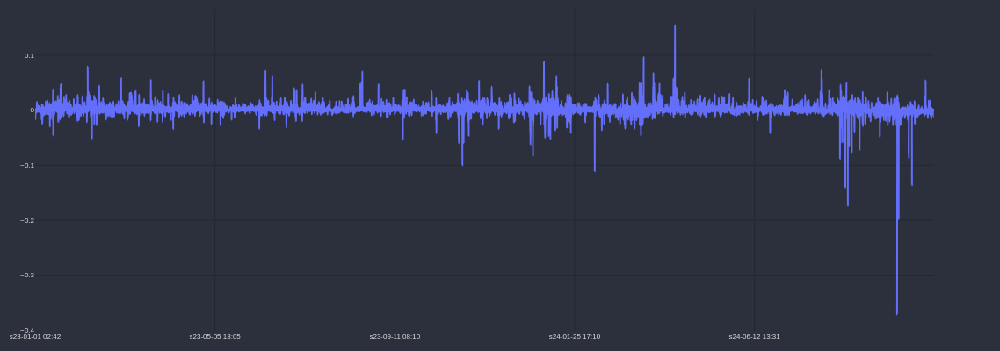

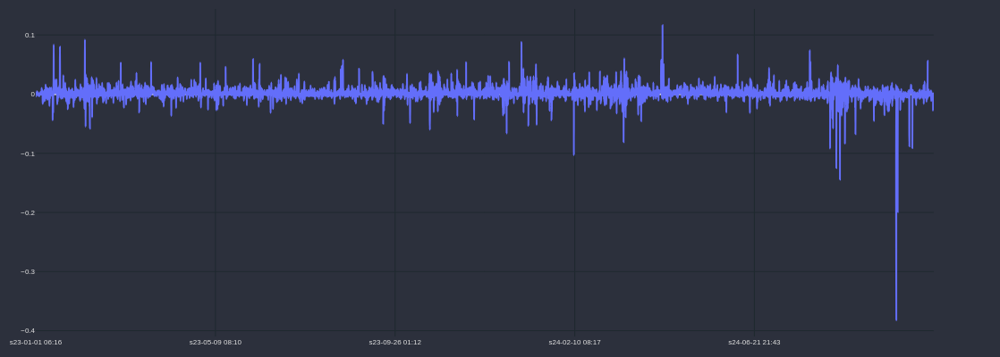

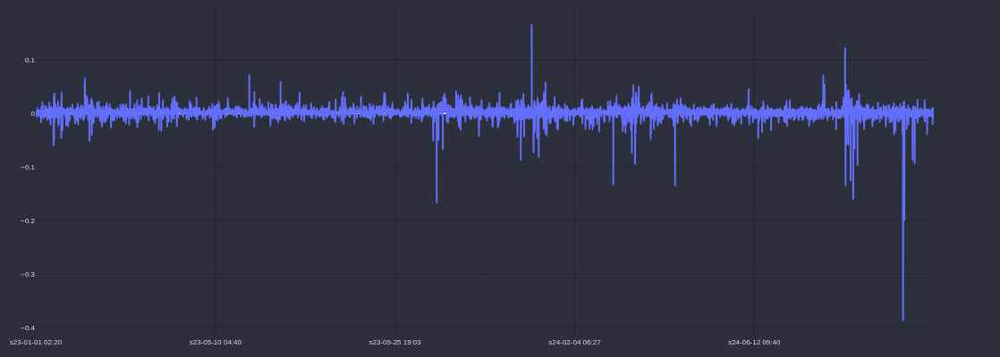

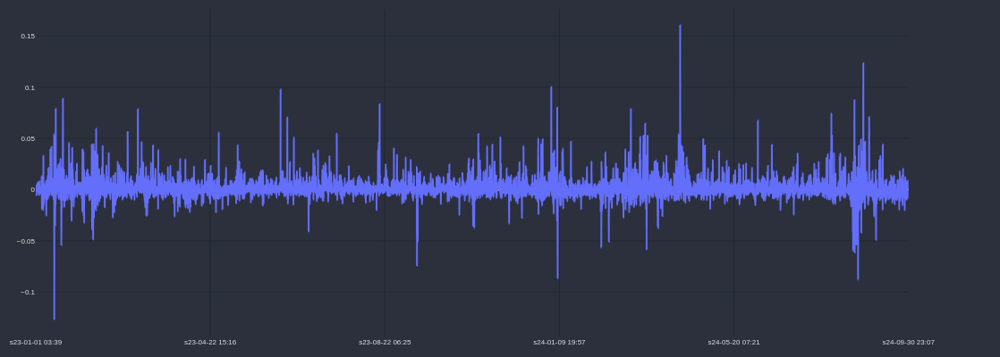

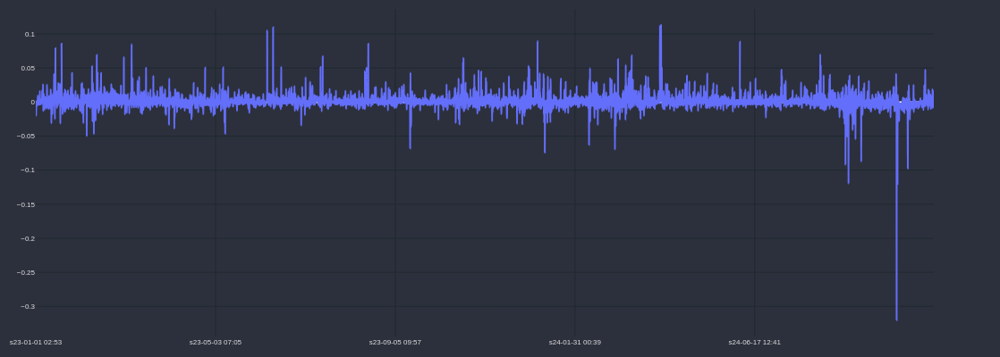

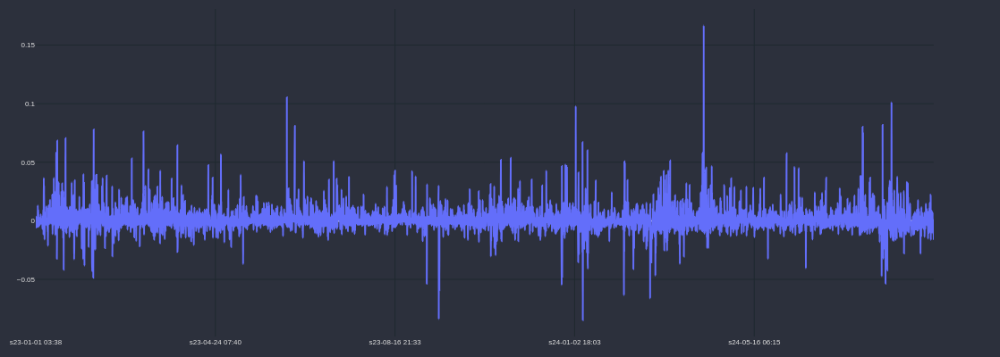

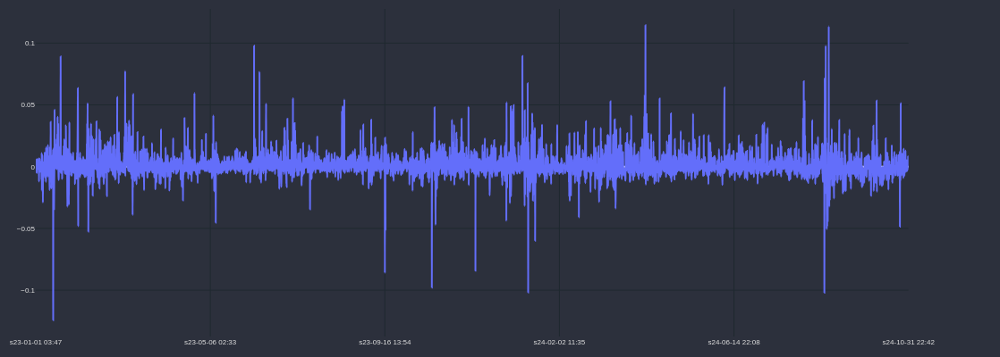

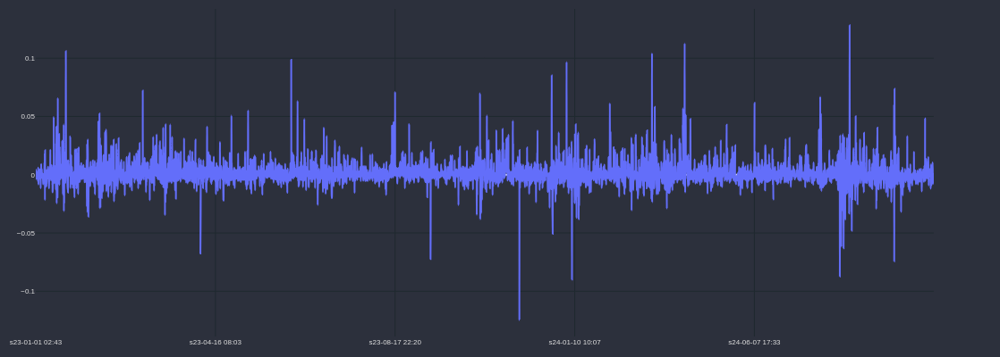

In [64]:
for i in range(8):
    df_result1 = df_res_test.iloc[i].r
    df_result1['time'] = df_result1['end_time']
    cp = CandlePlot(df_result1,candles=False)
    cp.show_plot(line_traces=['strategy_pair1'])

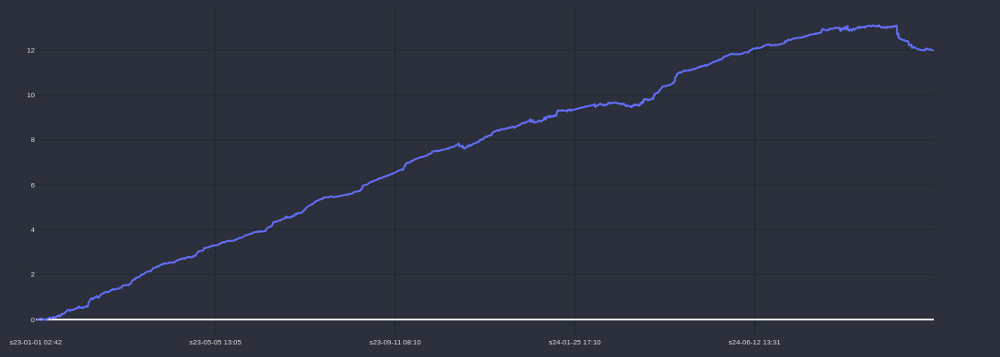

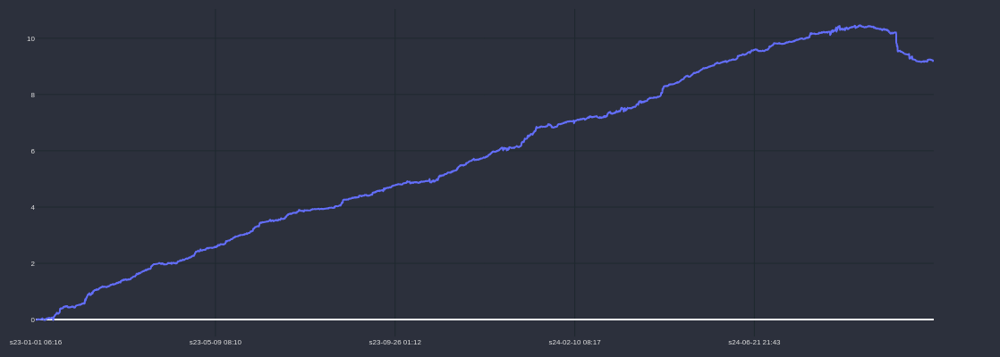

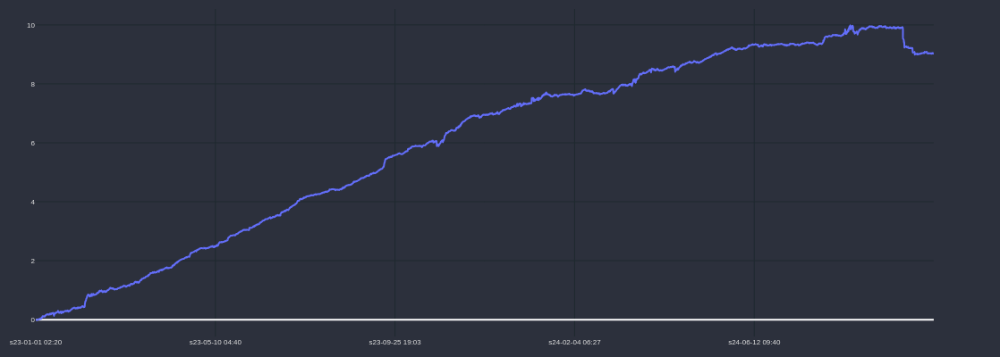

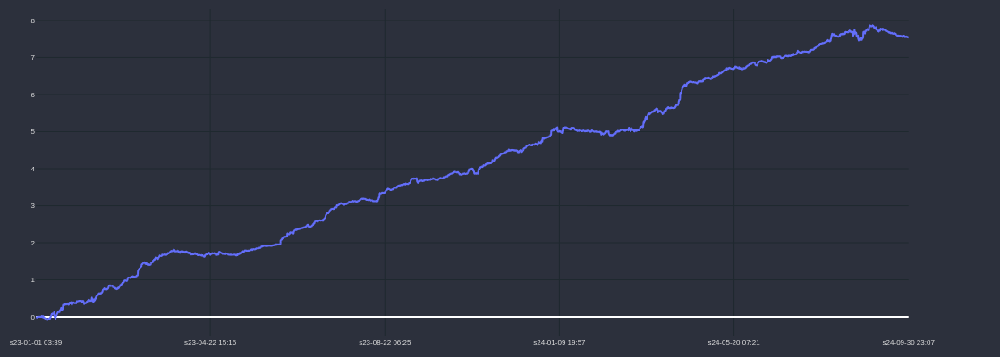

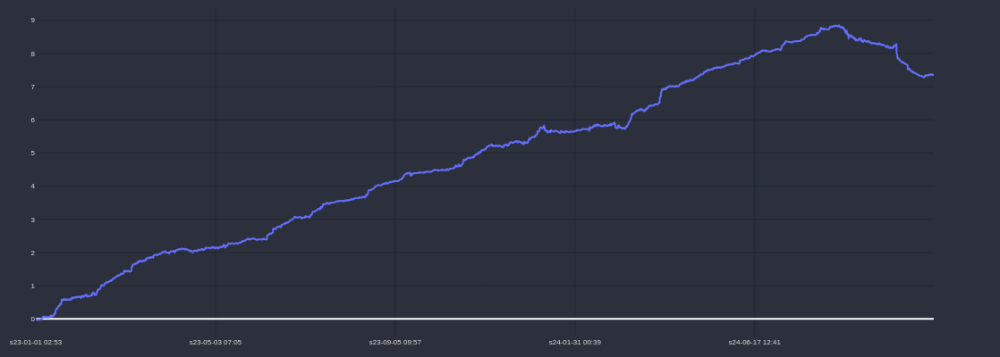

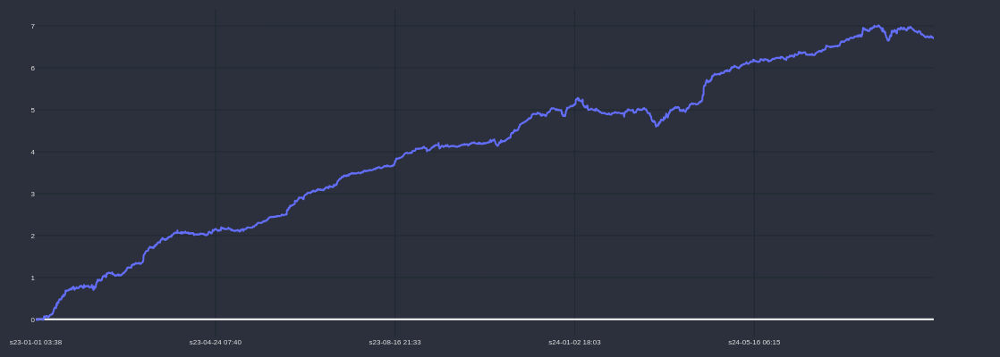

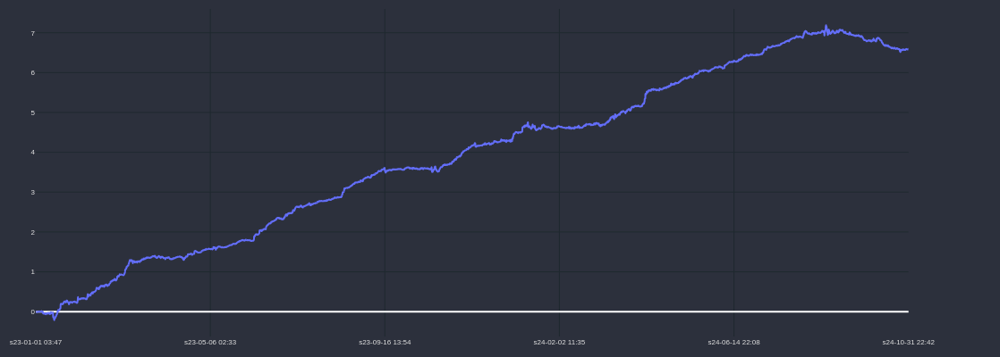

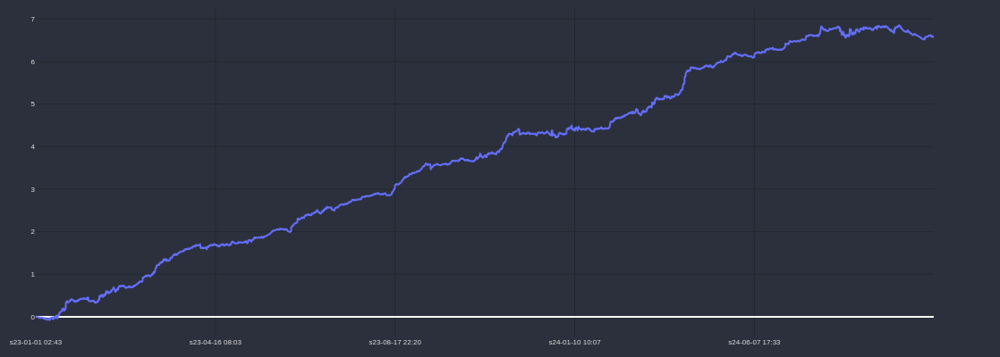

In [65]:
for i in range(8):
    df_result1 = df_res_test.iloc[i].r
    df_result1['time'] = df_result1['end_time']
    df_result1['gain'] = df_result1['strategy_pair1'].cumsum()
    cp = CandlePlot(df_result1,candles=False)
    cp.show_plot(line_traces=['gain'])

In [30]:
# ddf = lista[3]['res'].df.copy()
# ddf = lista[0]['res'].copy()
ddf = df_res_test.iloc[0]['df'].copy()
ddf.columns

Index(['Time', 'Close_Pair1', 'Close_Pair2', 'Spread', 'Spread_Mean',
       'Spread_Std', 'Z-Score', 'time', 'strategy_pair1', 'returns_pair1',
       'creturns_pair1', 'Log_Returns_pair1', 'cLog_Returns_pair1',
       'SIGNAL_UP_PAIR1', 'SIGNAL_DOWN_PAIR1', 'SIGNAL_UP_PAIR2',
       'SIGNAL_DOWN_PAIR2'],
      dtype='object')

In [31]:
df_result.trail_stop_trigger.value_counts()

trail_stop_trigger
0    4580
1    1098
Name: count, dtype: int64

In [32]:
df_result[df_result['strategy_pair1'] < 0].head(50)

,running,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,first_return,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time
0,False,67,47,0,-0.000411,3.888781e-04,1,False,0,0.05,-0.050,buy,0.02571,0.02572,1,0,0.00001,2023-01-01 02:42:00,2023-01-01 01:56:00,2023-01-01 02:42:00
1,False,279,66,0,-0.016456,-1.565590e-02,1,False,0,0.05,-0.050,buy,0.02575,0.02535,1,0,-0.00040,2023-01-01 06:33:00,2023-01-01 05:28:00,2023-01-01 06:33:00
2,False,512,62,0,-0.005883,-5.083100e-03,1,False,0,0.05,-0.050,buy,0.02564,0.02551,1,0,-0.00013,2023-01-01 10:22:00,2023-01-01 09:21:00,2023-01-01 10:22:00
3,False,617,24,0,-0.000800,-1.589440e-16,1,False,0,0.05,-0.050,buy,0.02546,0.02546,1,0,0.00000,2023-01-01 11:29:00,2023-01-01 11:06:00,2023-01-01 11:29:00
4,False,885,47,0,-0.001981,-1.180870e-03,1,False,0,0.05,-0.050,buy,0.02542,0.02539,1,0,-0.00003,2023-01-01 16:20:00,2023-01-01 15:34:00,2023-01-01 16:20:00
7,False,1325,54,0,-0.000411,3.885759e-04,1,False,0,0.05,-0.050,sell,0.02574,0.02573,0,1,0.00001,2023-01-01 23:47:00,2023-01-01 22:54:00,2023-01-01 23:47:00
9,False,1625,50,0,-0.004314,-3.513570e-03,1,False,0,0.05,-0.050,buy,0.02566,0.02557,1,0,-0.00009,2023-01-02 04:43:00,2023-01-02 03:54:00,2023-01-02 04:43:00
10,False,1696,10,0,-0.001974,-1.173939e-03,1,False,0,0.05,-0.050,buy,0.02557,0.02554,1,0,-0.00003,2023-01-02 05:14:00,2023-01-02 05:05:00,2023-01-02 05:14:00
13,False,2306,125,0,-0.000025,7.745934e-04,2,False,1,0.05,0.001,buy,0.02581,0.02583,1,0,0.00002,2023-01-02 17:19:00,2023-01-02 15:15:00,2023-01-02 17:19:00
15,False,2709,32,0,-0.000416,3.840983e-04,2,False,0,0.05,-0.050,buy,0.02603,0.02604,1,0,0.00001,2023-01-02 22:29:00,2023-01-02 21:58:00,2023-01-02 22:29:00


241 0


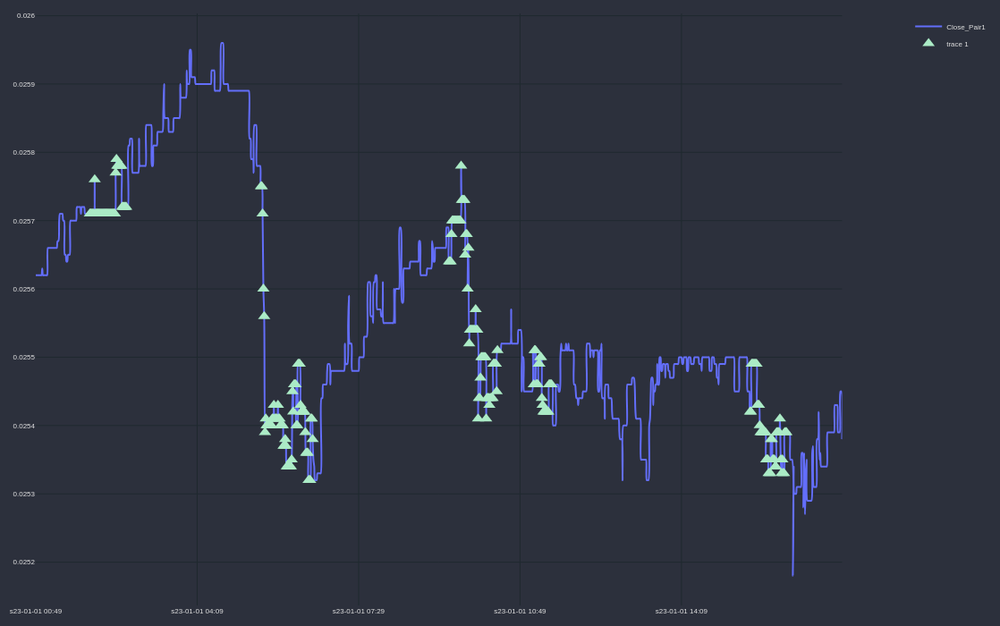

In [33]:
cp = CandlePlot(ddf.iloc[0:1000],candles=False)


trades_up = cp.df_plot[cp.df_plot.SIGNAL_UP_PAIR1 == 1]

trades_down = cp.df_plot[cp.df_plot.SIGNAL_DOWN_PAIR1 == 1]

print(len(trades_up),len(trades_down))



marker_trade_up = '#abebc6'
marker_trade_down = '#cccddd'


markers = 'Close_Pair1'


cp.add_traces(['Close_Pair1'])


# # SIGNAL UP
cp.fig.add_trace(go.Scatter(
    x = trades_up.sTime,
    y = trades_up[markers],
    mode = 'markers',
    marker_symbol = 'triangle-up',
    marker=dict(color=marker_trade_up, size=12)
))

cp.fig.add_trace(go.Scatter(
    x = trades_down.sTime,
    y = trades_down[markers],
    mode = 'markers',
    marker_symbol = 'triangle-down',
    marker=dict(color=marker_trade_down, size=12)
))


cp.show_plot(height=700, width=1100)#, sec_traces=[])




In [34]:
# cp = CandlePlot(ddf.iloc[0:20000],candles=False, is_subplots=False)

# cp.add_traces(['Close'])
# cp.show_plot(height=700, width=1100, sec_traces=['Average_EMA_percent_ema_short','Average_EMA_percent_ema_long'])

In [46]:
df_result.columns

Index(['running', 'start_index_m5', 'count', 'trigger_type', 'strategy',
       'strategy_no_tc', 'total_opened', 'first_return', 'trail_stop_trigger',
       'stop_loss_percent', 'trailing_stop_target', 'trailing_stop_loss',
       'type', 'start_price', 'trigger_price', 'SIGNAL_UP', 'SIGNAL_DOWN',
       'result', 'end_time', 'start_time', 'strategy_real', 'time', 'gain'],
      dtype='object')

In [47]:
df_result[df_result['start_time'] == '2024-09-27 02:33:00']

,running,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,first_return,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,strategy_real,time,gain


In [48]:
df = res[0]['res'].df
df.columns

Index(['Time', 'Open', 'High', 'Low', 'Close', 'Volume', 'time', 'strategy',
       'returns', 'creturns', 'Log_Returns', 'cLog_Returns', 'EMA_short',
       'EMA_long', 'Percent_Change_1', 'EMA_percent_s_1', 'Percent_Change_10',
       'EMA_percent_s_10', 'Percent_Change_50', 'EMA_percent_s_50',
       'Percent_Change_100', 'EMA_percent_s_100_5', 'EMA_percent_s_100_10',
       'EMA_percent_s_100_15', 'Percent_Change_150', 'EMA_percent_s_150_5',
       'EMA_percent_s_150_10', 'EMA_percent_s_150_15', 'Percent_Change_200',
       'EMA_percent_s_200_5', 'EMA_percent_s_200_10', 'EMA_percent_s_200_15',
       'Percent_Change_500', 'EMA_percent_s_500_5', 'Percent_Change_1000',
       'EMA_percent_s_1000_5', 'Percent_Change_2000', 'EMA_percent_s_2000_5',
       'Percent_Change_3000', 'EMA_percent_s_3000_5', 'Average_EMA_percent',
       'Average_EMA_percent_ema_short', 'Average_EMA_percent_ema_long',
       'Average_EMA_percent_ema_1', 'Average_EMA_percent_ema_5',
       'Average_EMA_percent_

In [49]:
index = df[df['time']=='2024-09-27 02:33:00'].index[0]
print(index)

209215


In [50]:
df_test = df.iloc[index:index+20]
df_test['strategy'] = df_test.returns.cumsum()
df_test['strategy2'] = (1 + df_test['returns']).cumprod() - 1
df_test[['Time', 'Close', 'Volume', 'strategy','strategy2','returns']]

,Time,Close,Volume,strategy,strategy2,returns
209215,2024-09-27 02:33:00,4.869,5695.38,4.108463e-04,0.000411,0.000411
209216,2024-09-27 02:34:00,4.870,3505.21,6.162062e-04,0.000616,0.000205
209217,2024-09-27 02:35:00,4.874,484.93,1.437224e-03,0.001438,0.000821
209218,2024-09-27 02:36:00,4.871,639.44,8.215240e-04,0.000821,-0.000616
209219,2024-09-27 02:37:00,4.866,2883.72,-2.054865e-04,-0.000207,-0.001027
209220,2024-09-27 02:38:00,4.864,3530.05,-6.165862e-04,-0.000618,-0.000411
209221,2024-09-27 02:39:00,4.867,399.68,1.717376e-16,-0.000001,0.000617
209222,2024-09-27 02:40:00,4.874,3016.60,1.437224e-03,0.001436,0.001437
209223,2024-09-27 02:41:00,4.874,1078.19,1.437224e-03,0.001436,0.000000
209224,2024-09-27 02:42:00,4.874,511.19,1.437224e-03,0.001436,0.000000


In [51]:
result = df_test['Close'].iloc[-1] - df_test['Close'].iloc[0]
round(result,4)

np.float64(0.004)

# Comparação de series temporais

Maior correlação em lag: -5


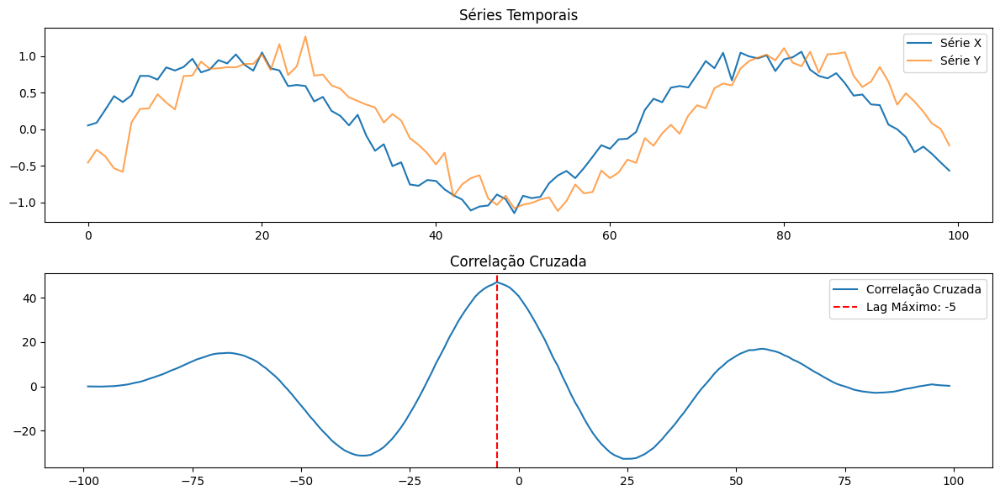

In [472]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import correlate

# Séries temporais
np.random.seed(42)
x = np.sin(np.linspace(0, 10, 100)) + np.random.normal(scale=0.1, size=100)
y = np.roll(x, shift=5) + np.random.normal(scale=0.1, size=100)

# Correlação cruzada
lags = np.arange(-len(x) + 1, len(x))
correlation = correlate(x, y, mode="full")

# Encontrar o lag com maior correlação
lag_max = lags[np.argmax(correlation)]
print(f"Maior correlação em lag: {lag_max}")

# Gráfico
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(x, label="Série X")
plt.plot(y, label="Série Y", alpha=0.7)
plt.title("Séries Temporais")
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(lags, correlation, label="Correlação Cruzada")
plt.axvline(lag_max, color="red", linestyle="--", label=f"Lag Máximo: {lag_max}")
plt.title("Correlação Cruzada")
plt.legend()
plt.tight_layout()
plt.show()


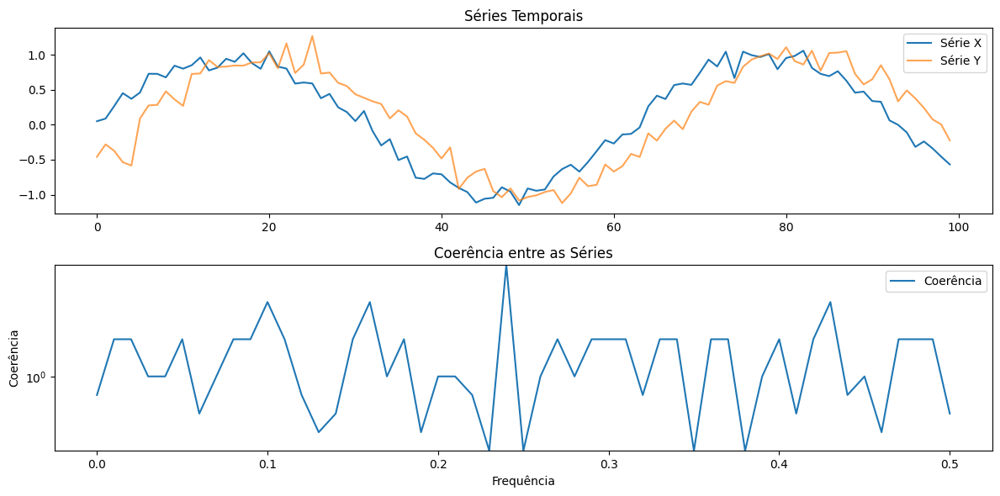

In [473]:
from scipy.signal import coherence

# Coerência entre as séries
f, Cxy = coherence(x, y, fs=1.0)

# Gráfico
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(x, label="Série X")
plt.plot(y, label="Série Y", alpha=0.7)
plt.title("Séries Temporais")
plt.legend()

plt.subplot(2, 1, 2)
plt.semilogy(f, Cxy, label="Coerência")
plt.title("Coerência entre as Séries")
plt.xlabel("Frequência")
plt.ylabel("Coerência")
plt.legend()
plt.tight_layout()
plt.show()


In [474]:
# from fastdtw import fastdtw
# from scipy.spatial.distance import euclidean

# # DTW entre as séries
# distance, path = fastdtw(x, y, dist=euclidean)
# print(f"Distância DTW: {distance}")

# # Gráfico
# plt.figure(figsize=(12, 6))
# plt.subplot(2, 1, 1)
# plt.plot(x, label="Série X")
# plt.plot(y, label="Série Y", alpha=0.7)
# plt.title("Séries Temporais")
# plt.legend()

# plt.subplot(2, 1, 2)
# plt.plot([p[0] for p in path], [p[1] for p in path], marker="o", linestyle="--")
# plt.title("Caminho DTW")
# plt.xlabel("Índices da Série X")
# plt.ylabel("Índices da Série Y")
# plt.tight_layout()
# plt.show()


Janelas com alta correlação: [0, 1, 2, 3, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 76, 77, 78, 79, 80]


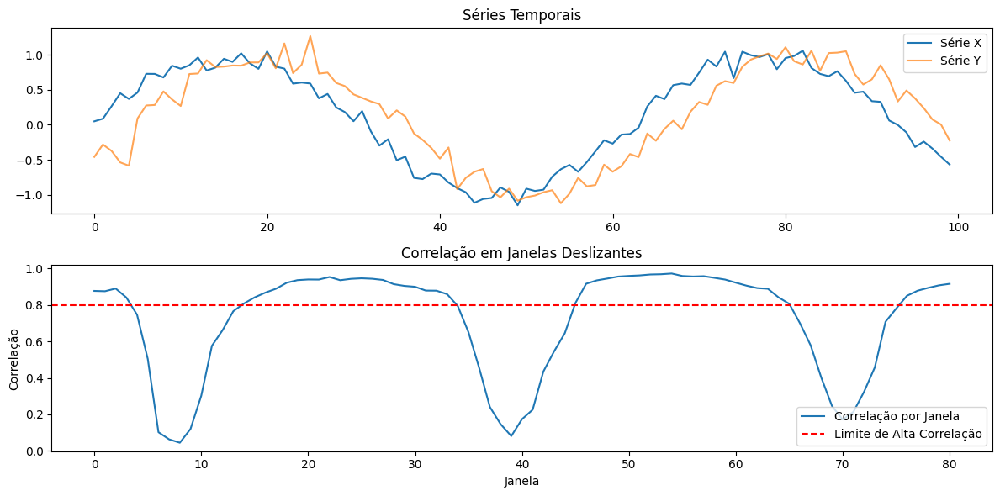

In [475]:
import pandas as pd

# Função para correlação em janelas
window_size = 20
correlations = [np.corrcoef(x[i:i+window_size], y[i:i+window_size])[0, 1] 
                for i in range(len(x) - window_size + 1)]

# Identificar janelas com alta correlação
high_corr_windows = [i for i, c in enumerate(correlations) if c > 0.8]
print(f"Janelas com alta correlação: {high_corr_windows}")

# Gráfico
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(x, label="Série X")
plt.plot(y, label="Série Y", alpha=0.7)
plt.title("Séries Temporais")
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(range(len(correlations)), correlations, label="Correlação por Janela")
plt.axhline(0.8, color="red", linestyle="--", label="Limite de Alta Correlação")
plt.title("Correlação em Janelas Deslizantes")
plt.xlabel("Janela")
plt.ylabel("Correlação")
plt.legend()
plt.tight_layout()
plt.show()


Informação Mútua: 0.9068418891231994


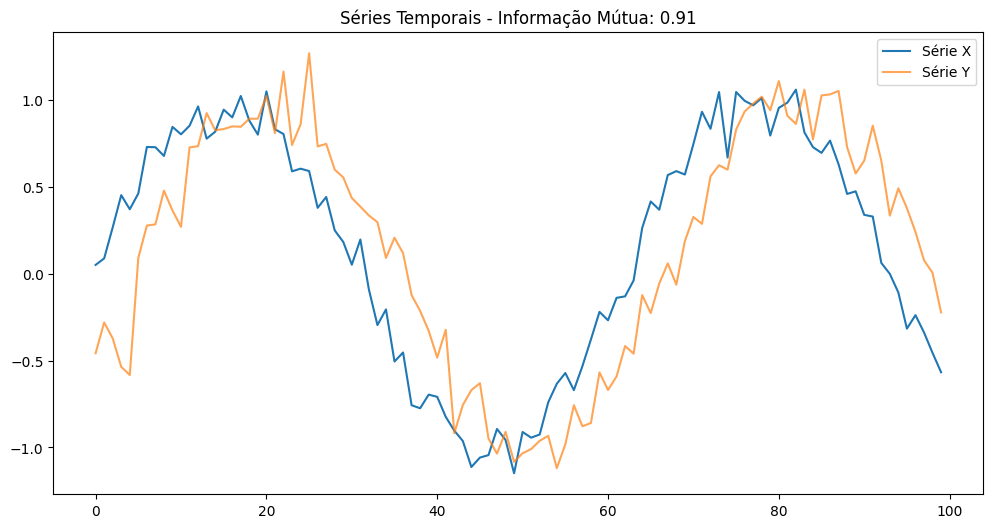

In [476]:
from sklearn.metrics import mutual_info_score

# Discretizar as séries para calcular mutual information
bins = 10
x_digitized = np.digitize(x, bins=np.histogram_bin_edges(x, bins=bins))
y_digitized = np.digitize(y, bins=np.histogram_bin_edges(y, bins=bins))
mi = mutual_info_score(x_digitized, y_digitized)
print(f"Informação Mútua: {mi}")

# Gráfico
plt.figure(figsize=(12, 6))
plt.plot(x, label="Série X")
plt.plot(y, label="Série Y", alpha=0.7)
plt.title(f"Séries Temporais - Informação Mútua: {mi:.2f}")
plt.legend()
plt.show()


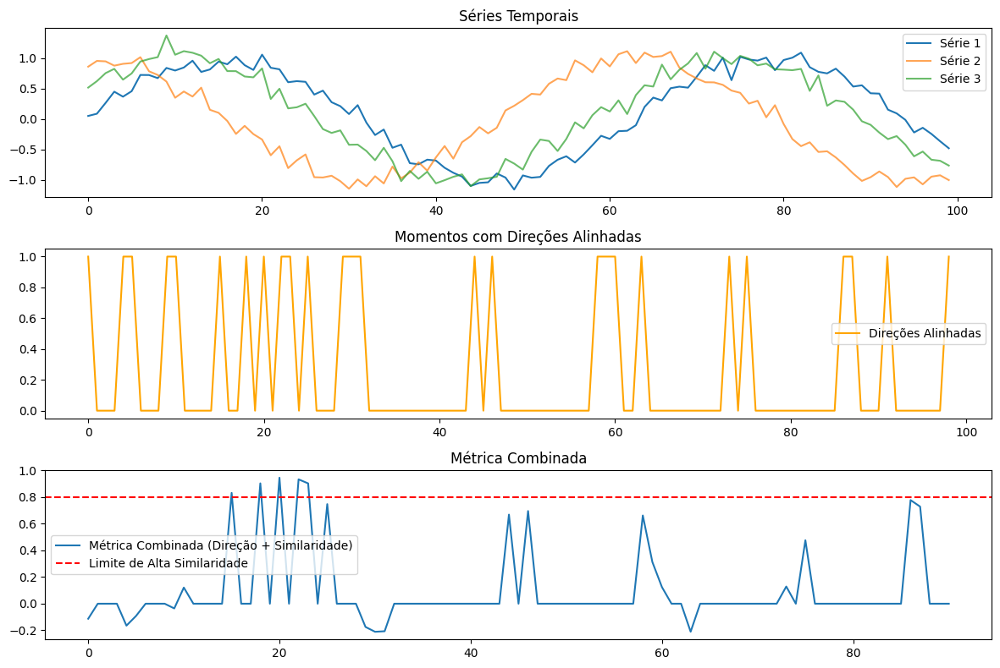

In [477]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import correlate

# Simulando três séries temporais caóticas
np.random.seed(42)
time = np.arange(0, 100)
series1 = np.sin(time / 10) + np.random.normal(scale=0.1, size=100)
series2 = np.cos(time / 10) + np.random.normal(scale=0.1, size=100)
series3 = np.sin(time / 10 + 0.5) + np.random.normal(scale=0.1, size=100)

# Função para calcular direções (diferenças consecutivas)
def calculate_directions(series):
    return np.sign(np.diff(series))

# Direções para as três séries
dir1 = calculate_directions(series1)
dir2 = calculate_directions(series2)
dir3 = calculate_directions(series3)

# Identificar momentos em que todas têm a mesma direção
aligned_directions = (dir1 == dir2) & (dir2 == dir3)

# Métrica de similaridade: Correlação por janelas
window_size = 10
similarities = []
for i in range(len(series1) - window_size + 1):
    corr12 = np.corrcoef(series1[i:i+window_size], series2[i:i+window_size])[0, 1]
    corr13 = np.corrcoef(series1[i:i+window_size], series3[i:i+window_size])[0, 1]
    corr23 = np.corrcoef(series2[i:i+window_size], series3[i:i+window_size])[0, 1]
    avg_corr = np.mean([corr12, corr13, corr23])
    similarities.append(avg_corr)

# Combinar alinhamento direcional e similaridade
combined_metric = np.array(similarities) * aligned_directions[:len(similarities)]

# Plotar as séries temporais
plt.figure(figsize=(12, 8))
plt.subplot(3, 1, 1)
plt.plot(time, series1, label="Série 1")
plt.plot(time, series2, label="Série 2", alpha=0.7)
plt.plot(time, series3, label="Série 3", alpha=0.7)
plt.title("Séries Temporais")
plt.legend()

# Plotar direções alinhadas
plt.subplot(3, 1, 2)
plt.plot(aligned_directions, label="Direções Alinhadas", color="orange")
plt.title("Momentos com Direções Alinhadas")
plt.legend()

# Plotar métrica combinada
plt.subplot(3, 1, 3)
plt.plot(combined_metric, label="Métrica Combinada (Direção + Similaridade)")
plt.axhline(0.8, color="red", linestyle="--", label="Limite de Alta Similaridade")
plt.title("Métrica Combinada")
plt.legend()
plt.tight_layout()
plt.show()


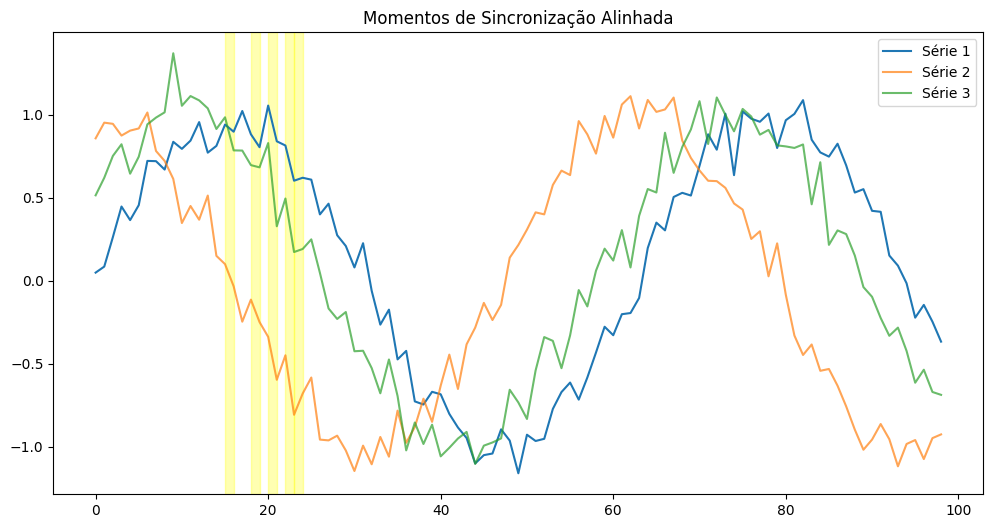

In [478]:
# Momentos de alta sincronização (combined_metric > 0.8)
high_sync = combined_metric > 0.8

# Plotar as séries com realce nos momentos sincronizados
plt.figure(figsize=(12, 6))
plt.plot(time[:-1], series1[:-1], label="Série 1")
plt.plot(time[:-1], series2[:-1], label="Série 2", alpha=0.7)
plt.plot(time[:-1], series3[:-1], label="Série 3", alpha=0.7)

# Destacar momentos de sincronização
for i in range(len(high_sync)):
    if high_sync[i]:
        plt.axvspan(time[i], time[i+1], color="yellow", alpha=0.3)

plt.title("Momentos de Sincronização Alinhada")
plt.legend()
plt.show()


In [479]:
import numpy as np
import pandas as pd

def analyze_series_with_windows(df, col1, col2, col3, window_size=20, direction_tolerance=0.05, slope_tolerance=0.1):
    """
    Analisa alinhamento de direção e inclinação rigorosamente entre três séries temporais
    utilizando janelas móveis.

    Args:
        df (pd.DataFrame): DataFrame contendo as séries temporais.
        col1, col2, col3 (str): Nomes das colunas das séries temporais.
        window_size (int): Tamanho da janela para análise.
        direction_tolerance (float): Tolerância para variação direcional.
        slope_tolerance (float): Tolerância para inclinação relativa.

    Returns:
        pd.DataFrame: DataFrame atualizado com as colunas 'aligned_directions' e 'combined_metric'.
    """
    def calculate_directions_and_slopes(window):
        """Calcula direção (+/-) e inclinação (diferenças normalizadas) em uma janela."""
        deltas = np.diff(window)
        directions = np.sign(deltas)
        normalized_slopes = deltas / (np.abs(deltas).mean() + 1e-6)  # Normalização para comparar
        return directions, normalized_slopes

    # Inicializar métricas
    aligned_directions = []
    combined_metric = []

    # Percorrer a série em janelas deslizantes
    for i in range(len(df) - window_size):
        # Extrair janelas
        window1 = df[col1].iloc[i:i + window_size].values
        window2 = df[col2].iloc[i:i + window_size].values
        window3 = df[col3].iloc[i:i + window_size].values

        # Calcular direções e inclinações para cada janela
        dir1, slope1 = calculate_directions_and_slopes(window1)
        dir2, slope2 = calculate_directions_and_slopes(window2)
        dir3, slope3 = calculate_directions_and_slopes(window3)

        # Verificar alinhamento de direção
        direction_alignment = (
            (np.abs(dir1 - dir2) <= direction_tolerance).all() &
            (np.abs(dir2 - dir3) <= direction_tolerance).all() &
            (np.abs(dir1 - dir3) <= direction_tolerance).all()
        )

        # Verificar inclinação semelhante
        slope_alignment = (
            (np.abs(slope1 - slope2) <= slope_tolerance).all() &
            (np.abs(slope2 - slope3) <= slope_tolerance).all() &
            (np.abs(slope1 - slope3) <= slope_tolerance).all()
        )

        # Combinar métricas (0 ou 1)
        aligned_directions.append(int(direction_alignment))
        combined_metric.append(int(direction_alignment and slope_alignment))

    # Ajustar tamanhos para adicionar ao DataFrame
    aligned_directions_full = [0] * (window_size - 1) + aligned_directions + [0]
    combined_metric_full = [0] * (window_size - 1) + combined_metric + [0]

    # Adicionar ao DataFrame
    df['aligned_directions'] = aligned_directions_full
    df['combined_metric'] = combined_metric_full
    
    return df


In [480]:


df = analyze_series_with_windows(ddf.iloc[0:10000], 'EMA_percent_s_100_5','EMA_percent_s_150_5','EMA_percent_s_200_5', window_size=10, direction_tolerance=0.2, slope_tolerance=0.2)



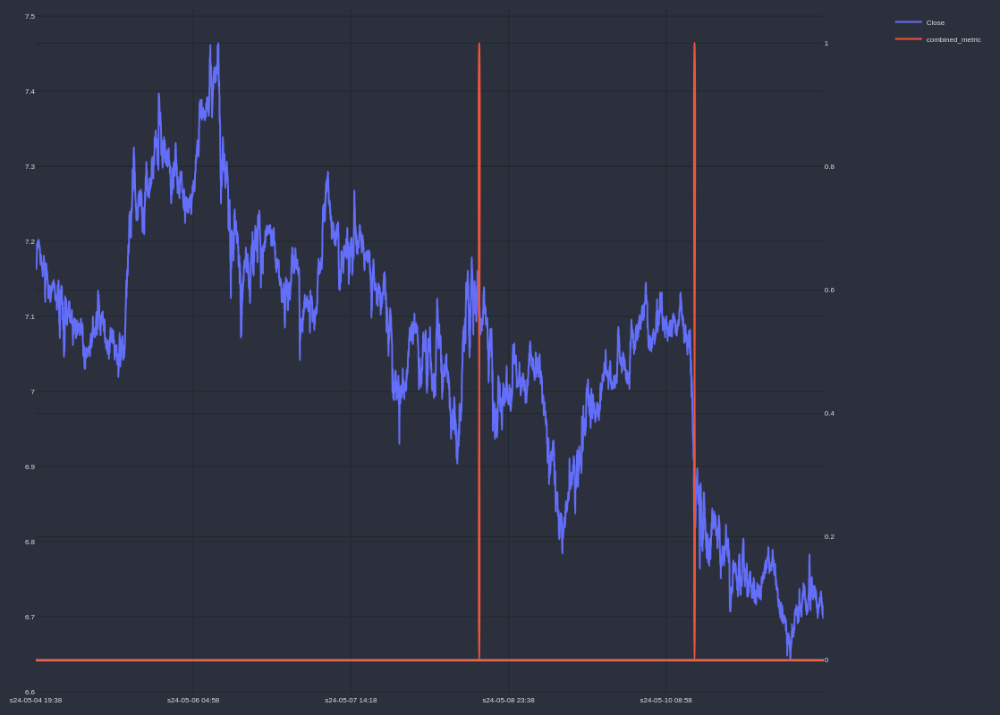

In [481]:
cp = CandlePlot(df,candles=False)
cp.show_plot(height=800,line_traces=['Close'],sec_traces=['combined_metric'])

In [518]:
import numpy as np
import pandas as pd

def analyze_series_similarity(df, col1, col2, col3, window_size=20, curvature_threshold=0.05, magnitude_tolerance=0.1, shape_correlation_threshold=0.9):
    """
    Analisa movimentos similares entre três séries temporais com base em curvatura, magnitude e forma.

    Args:
        df (pd.DataFrame): DataFrame contendo as séries temporais.
        col1, col2, col3 (str): Nomes das colunas das séries temporais.
        window_size (int): Tamanho da janela para análise.
        curvature_threshold (float): Limite mínimo para identificar curvatura significativa.
        magnitude_tolerance (float): Tolerância para diferenças em magnitude.
        shape_correlation_threshold (float): Limite mínimo de correlação para padrões similares.

    Returns:
        pd.DataFrame: DataFrame atualizado com as colunas 'similarity_metric' e 'similarity_sync'.
    """
    def calculate_curvature(series):
        """Calcula a segunda derivada aproximada (curvatura) de uma série."""
        first_derivative = np.diff(series)
        second_derivative = np.diff(first_derivative)
        curvature = np.append([0, 0], second_derivative)  # Ajustar para tamanho original
        return curvature

    def is_magnitude_similar(series1, series2, tolerance):
        """Verifica se as magnitudes das duas séries estão dentro da tolerância."""
        diff = np.abs(series1 - series2)
        return np.all(diff <= tolerance)

    def is_shape_similar(window1, window2, threshold):
        """Verifica se as formas das duas séries são semelhantes usando correlação."""
        correlation = np.corrcoef(window1, window2)[0, 1]
        return correlation >= threshold

    # Calcular curvaturas para cada série
    curvature1 = calculate_curvature(df[col1])
    curvature2 = calculate_curvature(df[col2])
    curvature3 = calculate_curvature(df[col3])

    # Inicializar métricas
    similarity_metric = []
    similarity_sync = []

    # Analisar janelas deslizantes
    for i in range(len(df) - window_size):
        # Extrair janelas
        window1 = df[col1].iloc[i:i + window_size].values
        window2 = df[col2].iloc[i:i + window_size].values
        window3 = df[col3].iloc[i:i + window_size].values

        # Verificar curvatura significativa
        curv1 = np.abs(curvature1[i:i + window_size]) > curvature_threshold
        curv2 = np.abs(curvature2[i:i + window_size]) > curvature_threshold
        curv3 = np.abs(curvature3[i:i + window_size]) > curvature_threshold

        if np.any(curv1) and np.any(curv2) and np.any(curv3):
            # Verificar semelhança de magnitude
            mag12 = is_magnitude_similar(window1, window2, magnitude_tolerance)
            mag13 = is_magnitude_similar(window1, window3, magnitude_tolerance)
            mag23 = is_magnitude_similar(window2, window3, magnitude_tolerance)

            # Verificar semelhança de forma
            shape12 = is_shape_similar(window1, window2, shape_correlation_threshold)
            shape13 = is_shape_similar(window1, window3, shape_correlation_threshold)
            shape23 = is_shape_similar(window2, window3, shape_correlation_threshold)

            # Determinar sincronização
            if mag12 and mag13 and mag23 and shape12 and shape13 and shape23:
                similarity_sync.append(1)
            else:
                similarity_sync.append(0)

            # Curvatura geral da janela
            similarity_metric.append(1)
        else:
            similarity_sync.append(0)
            similarity_metric.append(0)

    # Ajustar métricas para o tamanho do DataFrame
    similarity_metric_full = [0] * (window_size - 1) + similarity_metric + [0]
    similarity_sync_full = [0] * (window_size - 1) + similarity_sync + [0]

    # Adicionar resultados ao DataFrame
    df['similarity_metric'] = similarity_metric_full
    df['similarity_sync'] = similarity_sync_full
    
    return df


In [540]:



# Aplicar a função de análise de similaridade
df = analyze_series_similarity(
    ddf.iloc[0:10000], 
    'EMA_percent_s_100_5', 
    'EMA_percent_s_150_5', 
    'EMA_percent_s_200_5', 
    window_size=20, 
    curvature_threshold=0.05, 
    magnitude_tolerance=0.01, 
    shape_correlation_threshold=0.01
)


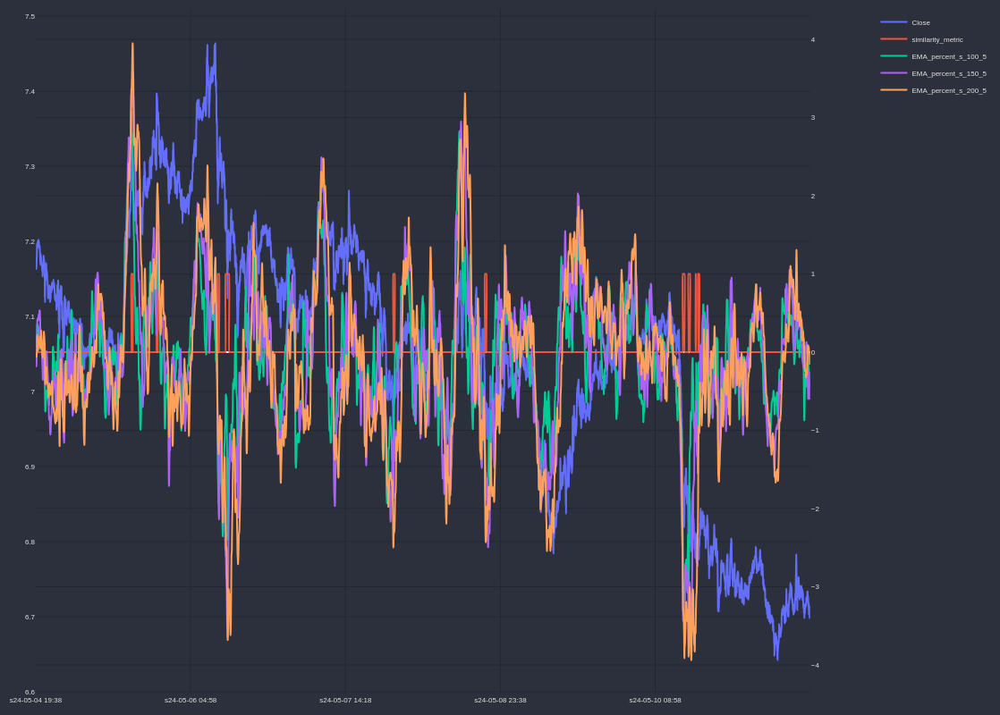

In [541]:


cp = CandlePlot(df,candles=False)
cp.show_plot(height=800,line_traces=['Close'],sec_traces=['similarity_metric','EMA_percent_s_100_5','EMA_percent_s_150_5','EMA_percent_s_200_5'])


